## Lab4: Image processing and working with digital image file sets


### Objective: Gain knowledge and skills in digital image processing using the Pillow and/or OpenCV libraries and image set processing work.

### Завдання 1. Робота з набором файлів.

1) Сформувати в папці на диску набір із 15 зображень різних форматів, розмірів та колірних моделей. Додати туди 2-3 файли, що не є зображеннями.
2) Створити функцію, що в якості аргумента приймає адресу папки на диску та повертає датафрейм з наступною інформацією про зображення, що знаходяться в папці:
- ім’я файлу;
- кольорову модель;
- формат;
- кількість каналів у зображенні;
- розмір файлу у мегабайтах байтах, округлених до двох знаків після коми;
- ширину картинки;
- висоту картинки;
- повний шлях до файлу;
- зменшене зображення.

Зауваження:

а) Якщо файл не є зображенням не додавати інформацію про нього в датафрейм.

б) Для обробки набору файлів можете скористатися вбудованими модулями glob 
(https://docs.python.org/3/library/glob.html), або zipfile https://docs.python.org/3/library/zipfile.html

в) Для відображення картинки в датафреймі можете скористатись методом, описаним в наступному матеріалі


In [11]:
import os
from PIL import Image
import pandas as pd
import numpy as np
import random
from PIL import ImageOps
from IPython.display import display
import re
import base64
from IPython.display import HTML

In [12]:
def image_formatter(image_path):
    with open(image_path, "rb") as image_file:
        encoded_image = base64.b64encode(image_file.read()).decode('utf-8')
        return f'<img src="data:image/png;base64,{encoded_image}" width="128">'

In [13]:
def extract_number(filename):
    match = re.search(r'\d+', filename)
    return int(match.group()) if match else float('inf')

In [14]:
def get_images_info(folder_path):
    columns = ['Name', 'Color Model', 'Format', 'Channels', 'Size',
               'Width', 'Height', 'Full Path', 'Image']
    df = pd.DataFrame(columns=columns)

    for filename in sorted(os.listdir(folder_path), key=extract_number):
        file_path = os.path.join(folder_path, filename)

        try:
            image = Image.open(file_path)
        except:
            continue

        file_size_mb = round(os.path.getsize(file_path) / (1024 * 1024), 2)
        resized_image = image.resize((100, 100))

        df = pd.concat([df, pd.DataFrame({
            'Name': [filename],
            'Color Model': [image.mode],
            'Format': [image.format],
            'Channels': [len(image.getbands())],
            'Size': [file_size_mb],
            'Width': [image.width],
            'Height': [image.height],
            'Full Path': [file_path],
            'Image': [resized_image]
        })], ignore_index=True)

    df.index = df.index + 1

    return df

/var/folders/0q/vd8vp_qd01bd8sd6_z13gjq80000gn/T/ipykernel_21137/2123467016.py:17: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, pd.DataFrame({


,Name,Color Model,Format,Channels,Size,Width,Height,Full Path,Image
1,1.png,RGBA,PNG,4,0.54,708,492,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/1.png,
2,2.png,RGBA,PNG,4,1.08,1080,770,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/2.png,
3,3.png,RGBA,PNG,4,1.28,1080,770,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/3.png,
4,4.png,RGBA,PNG,4,1.32,1080,700,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/4.png,
5,5.png,RGBA,PNG,4,0.80,1074,700,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/5.png,
6,6.png,RGBA,PNG,4,0.49,1074,700,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/6.png,
7,7.png,RGBA,PNG,4,0.85,1074,700,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/7.png,
8,8.png,RGBA,PNG,4,0.49,1074,700,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/8.png,
9,9.png,RGBA,PNG,4,1.36,1074,762,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/9.png,
10,10.png,RGBA,PNG,4,0.68,1074,762,/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images/10.png,

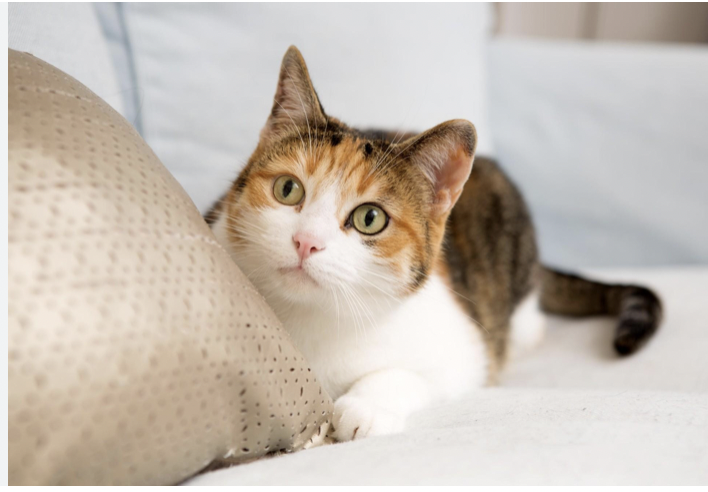
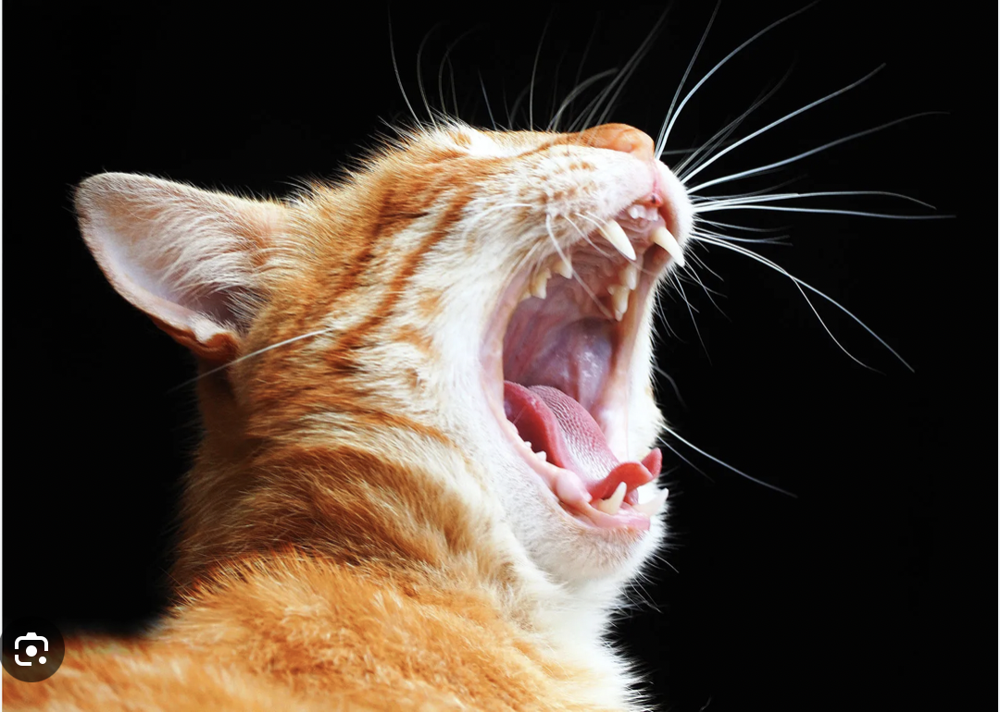
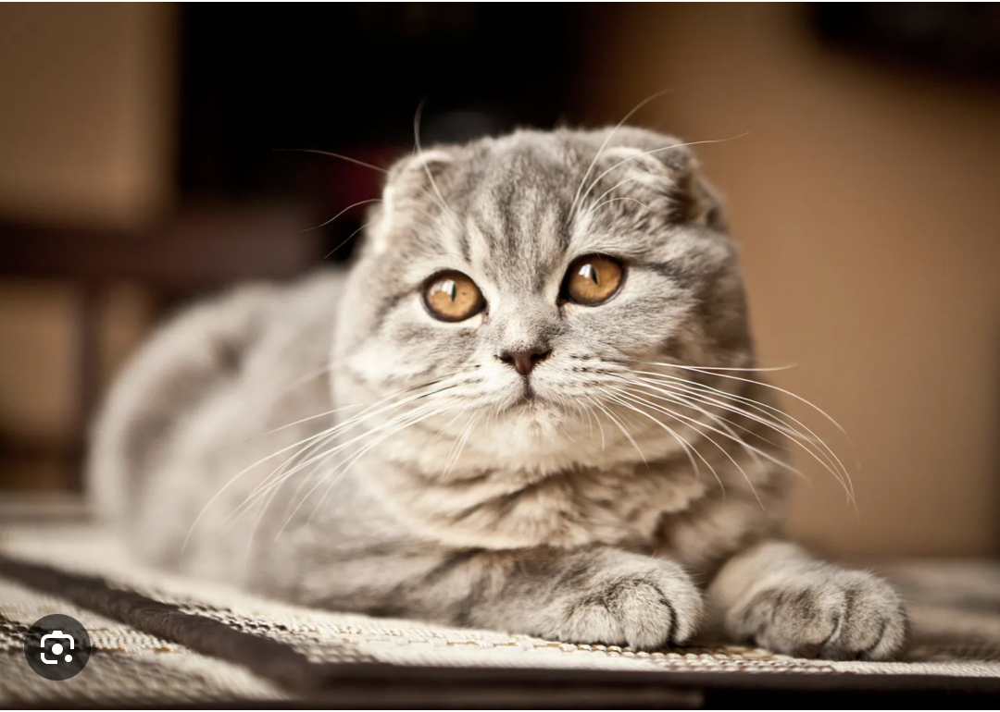
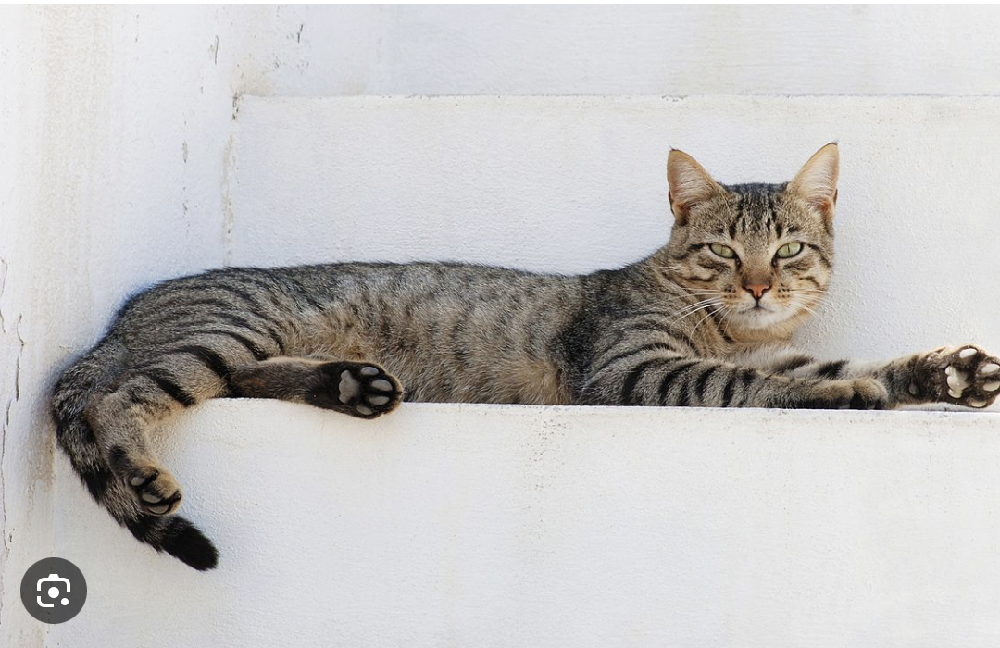
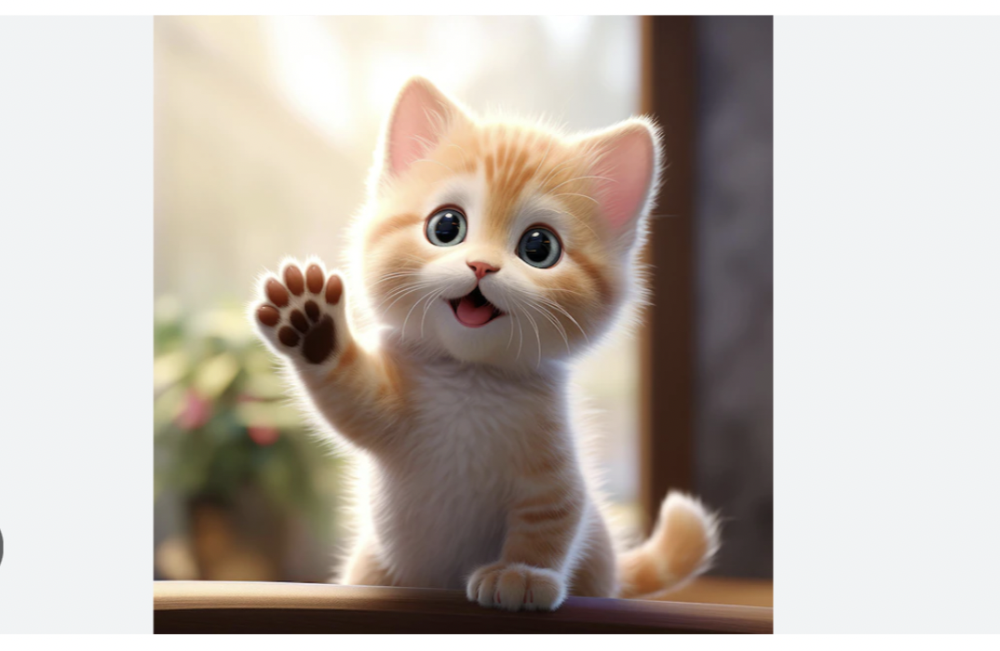
...
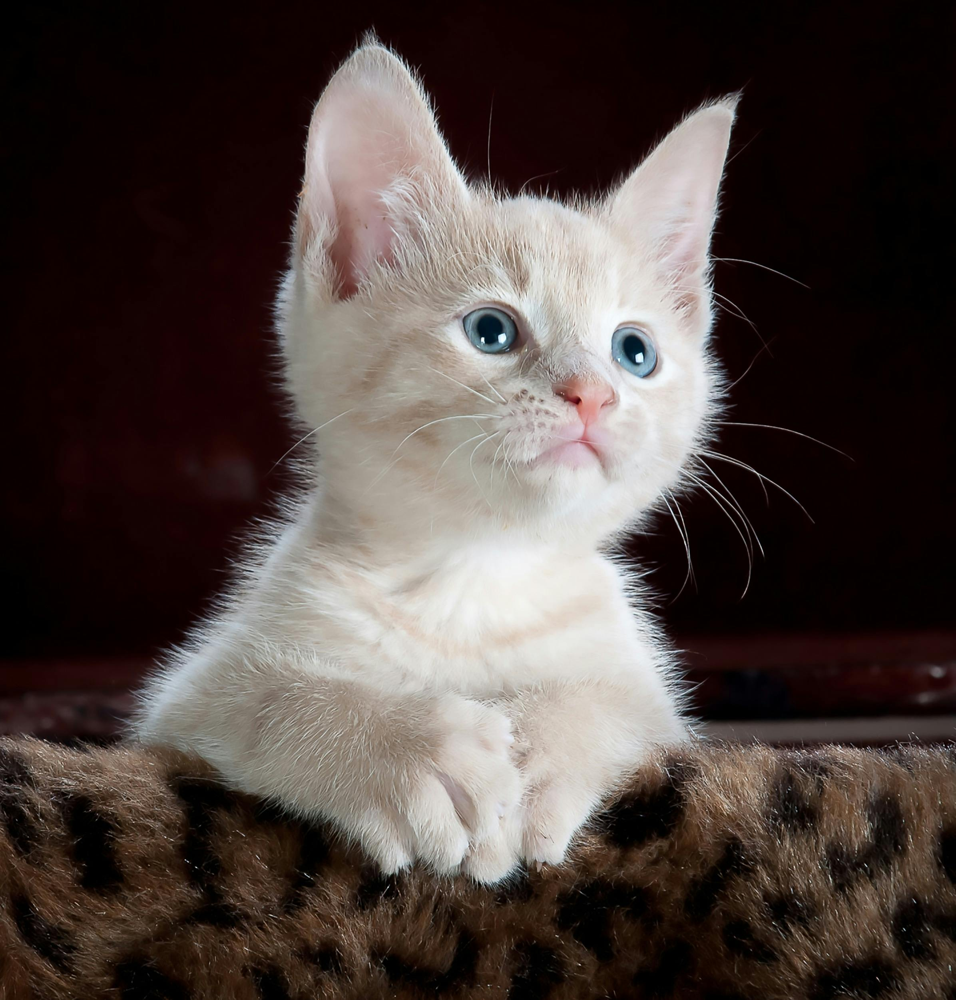
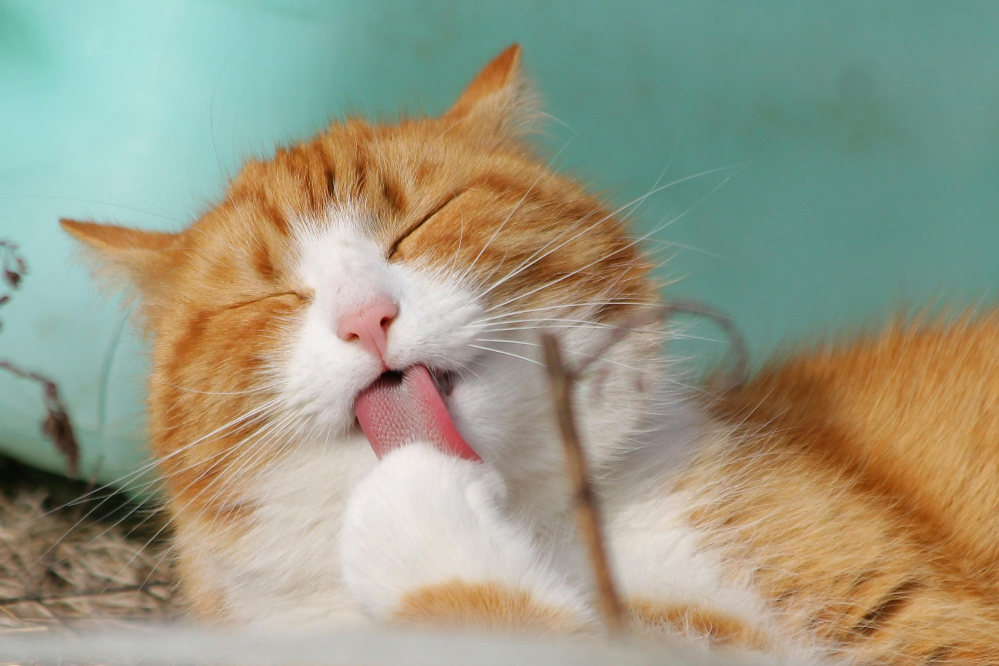
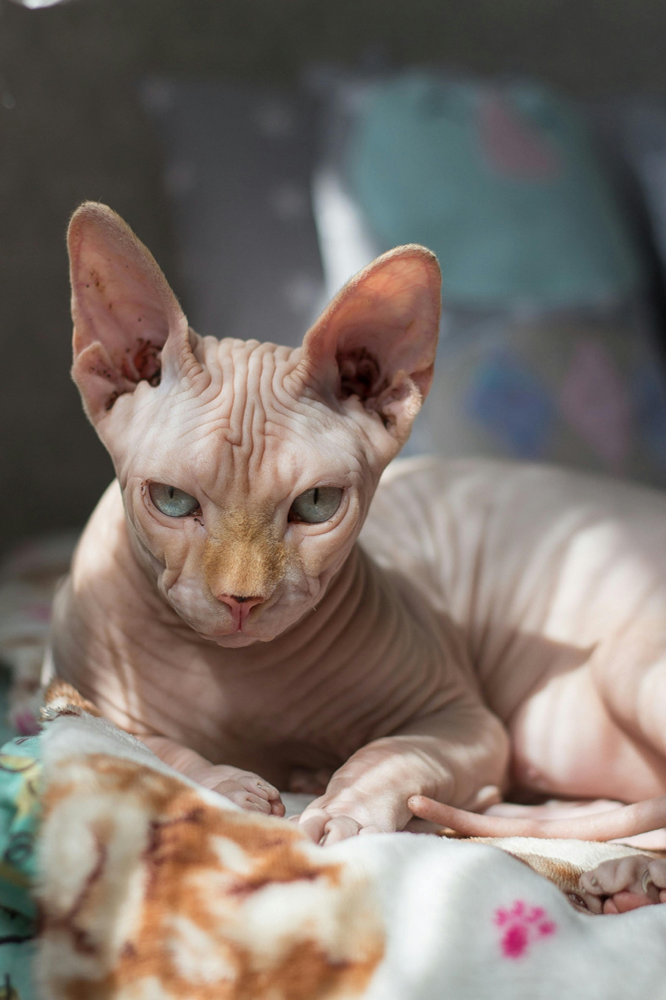
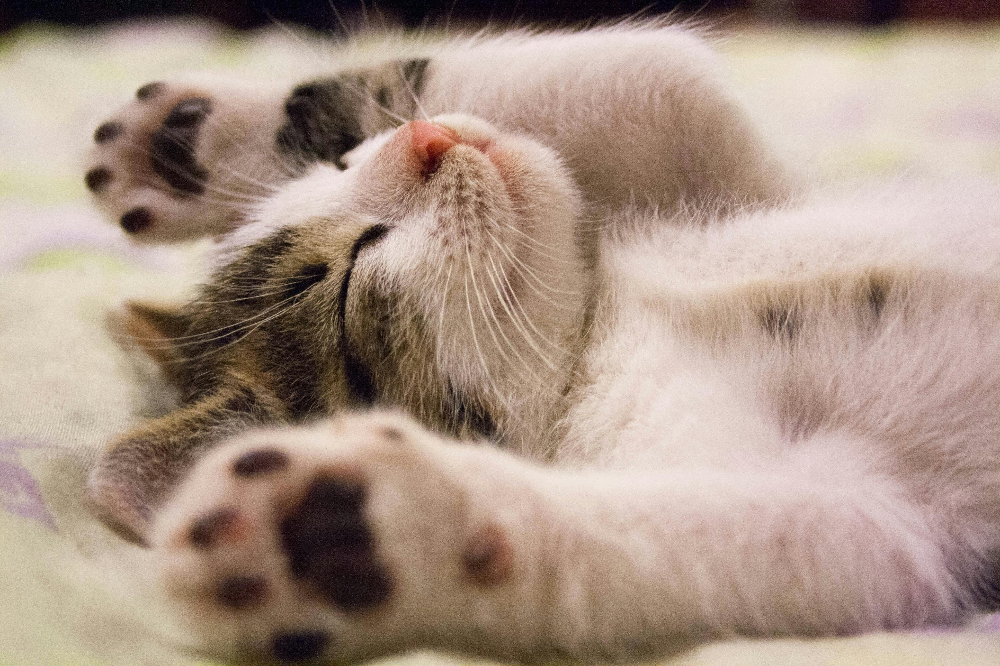
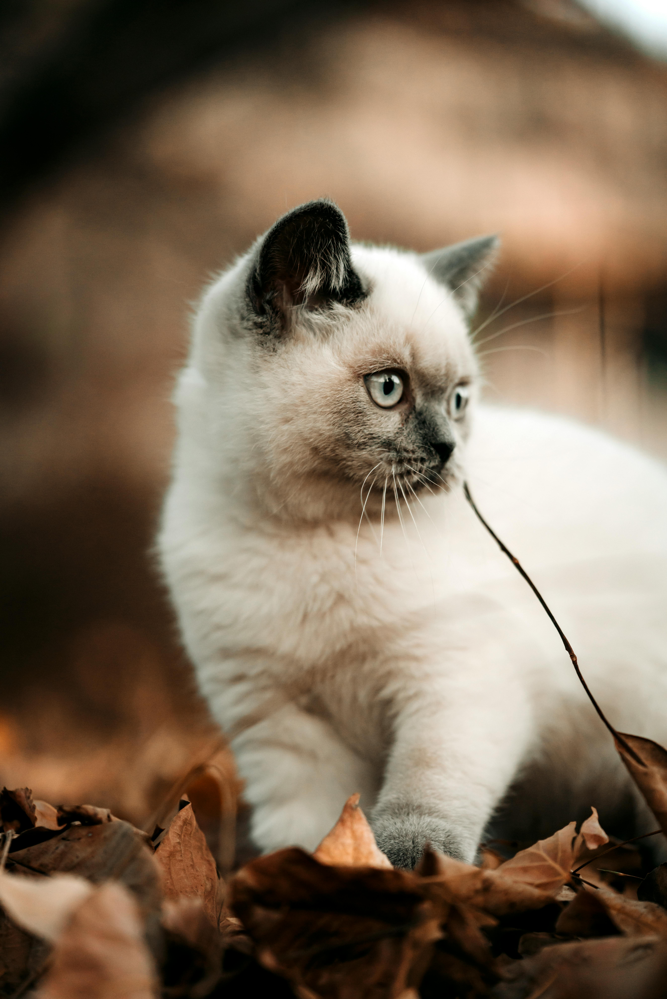

In [15]:
folder_path = '/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images'
df_images_info = get_images_info(folder_path)

#print(df_images_info)

df_images_info['Image'] = df_images_info['Full Path'].apply(image_formatter)
display(HTML(df_images_info.to_html(escape=False)))

### Завдання 2.
Створити функцію, що в якості аргумента приймає:
- шлях до папки;
- назва вихідного зображення;
- кількість зображень в рядку;
- кількість зображень в стовпчику
і повертає зображення постера.
Вважаємо, що постер є прямокутним і число картинок в постері a * b, де а –
число стовпчиків, а b – число рядків.

Зауваження:

1) Створити функцію, що перетворює картинку на квадрат з максимально можливим розміром сторони (наприклад, якщо картинка розміром 800*533, то вихідний розмір повинен бути 533533). Обрізаємо картинку з двох країв, тобто розмір розраховуємо від центру.

2) Всі картинки, з яких створено постер, повинні бути однакового розміру, Тобто після обрізки необхідно змінити розмір, наприклад, на 500*500.

3) Картинки для додавання в постер обирати випадковим чином. Картинки можуть повторюватись.

4) На картинку «накласти фільтр» червоного, зеленого, синього, жовтого, пурпурного або голубого кольорів, що також обираються випадковим чином та можуть повторюватись.

5) Надати 3-4 варіанти постерів, що збережено у файлах на диску.

6) Використовувати зображення, що знаходяться в папці, що сформована в завданні 1

7) Для обробки зображень використовувати бібліотеки Pillow та/або OpenCV

In [49]:
import os
import random
from PIL import Image, ImageOps

def apply_random_filter(image, opacity=0.5):
    # Available filters 
    filters = ['RED', 'GREEN', 'BLUE', 'YELLOW', 'PURPLE', 'CYAN']
    selected_filter = random.choice(filters)
    filter_colors = {
        'RED': '#FF0000',
        'GREEN': '#00FF00',
        'BLUE': '#0000FF',
        'YELLOW': '#FFFF00',
        'PURPLE': '#800080',
        'CYAN': '#00FFFF'
    }
    filter_color = filter_colors[selected_filter]

    # Create a colorized overlay with the same size  as original img
    grayscale = image.convert('L')
    filter_image = ImageOps.colorize(grayscale, black=filter_color, white=filter_color)
    filter_image = filter_image.convert("RGB").resize(image.size)

    # Blend the filter with the original image
    blended_image = Image.blend(image.convert("RGB"), filter_image, opacity)

    return blended_image

def create_square_image(image):
    # Crop the image to a square by taking the center
    side_length = min(image.size)
    square_image = ImageOps.fit(image, (side_length, side_length), method=0, bleed=0.0, centering=(0.5, 0.5))
    return square_image

def to_poster(folder_path, output_filename, columns, rows, num_variants=3):
    # List all image files in the specified folder
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    for variant in range(num_variants):
        # Initialize a blank poster image
        poster = Image.new('RGB', (columns * 500, rows * 500))

        for i in range(rows):
            for j in range(columns):
                # take a random img file for each cell in the poster
                image_path = os.path.join(folder_path, random.choice(image_files))
                original_image = Image.open(image_path)

                # create a square version of the img, resize it, and apply a random filter
                square_image = create_square_image(original_image)
                resized_image = square_image.resize((500, 500))
                filtered_image = apply_random_filter(resized_image)

                # add the result image into the poster
                poster.paste(filtered_image, (j * 500, i * 500))

        #  poster with a unique filename for each variant
        poster_filename = f"{output_filename}_variant_{variant + 1}.jpg"
        poster_path = os.path.join(folder_path, poster_filename)
        poster.save(poster_path)

    print(f"{num_variants} posters created and saved in {folder_path}")

folder_path = '/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images'
to_poster(folder_path, 'poster', columns=3, rows=3, num_variants=4)

4 posters created and saved in /Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images


In [58]:
def apply_random_filter(image, opacity=0.5):
    filters = ['RED', 'GREEN', 'BLUE', 'YELLOW', 'PURPLE', 'CYAN']
    selected_filter = random.choice(filters)
    filter_colors = {
        'RED': '#FF0000',
        'GREEN': '#00FF00',
        'BLUE': '#0000FF',
        'YELLOW': '#FFFF00',
        'PURPLE': '#800080',
        'CYAN': '#00FFFF'
    }
    filter_color = filter_colors[selected_filter]

    # Create a colorized overlay with the same size as original img
    grayscale = image.convert('L')
    filter_image = ImageOps.colorize(grayscale, black=filter_color, white=filter_color)
    filter_image = filter_image.convert("RGB").resize(image.size)

    # Blend the filter with the original image
    blended_image = Image.blend(image.convert("RGB"), filter_image, opacity)

    return blended_image

In [59]:
def create_square_image(image):
    # make the image a squared by taking the center
    side_length = min(image.size)
    square_image = ImageOps.fit(image, (side_length, side_length), method=0, bleed=0.0, centering=(0.5, 0.5))
    return square_image

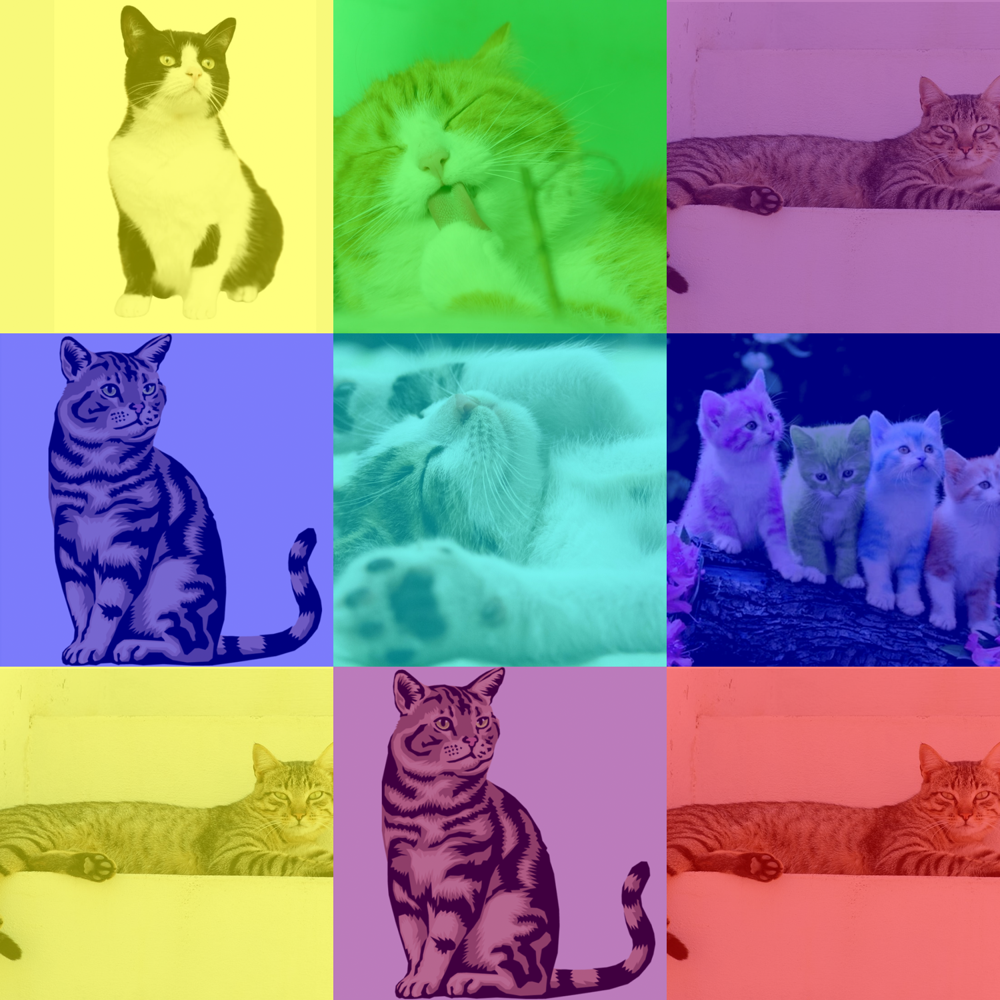

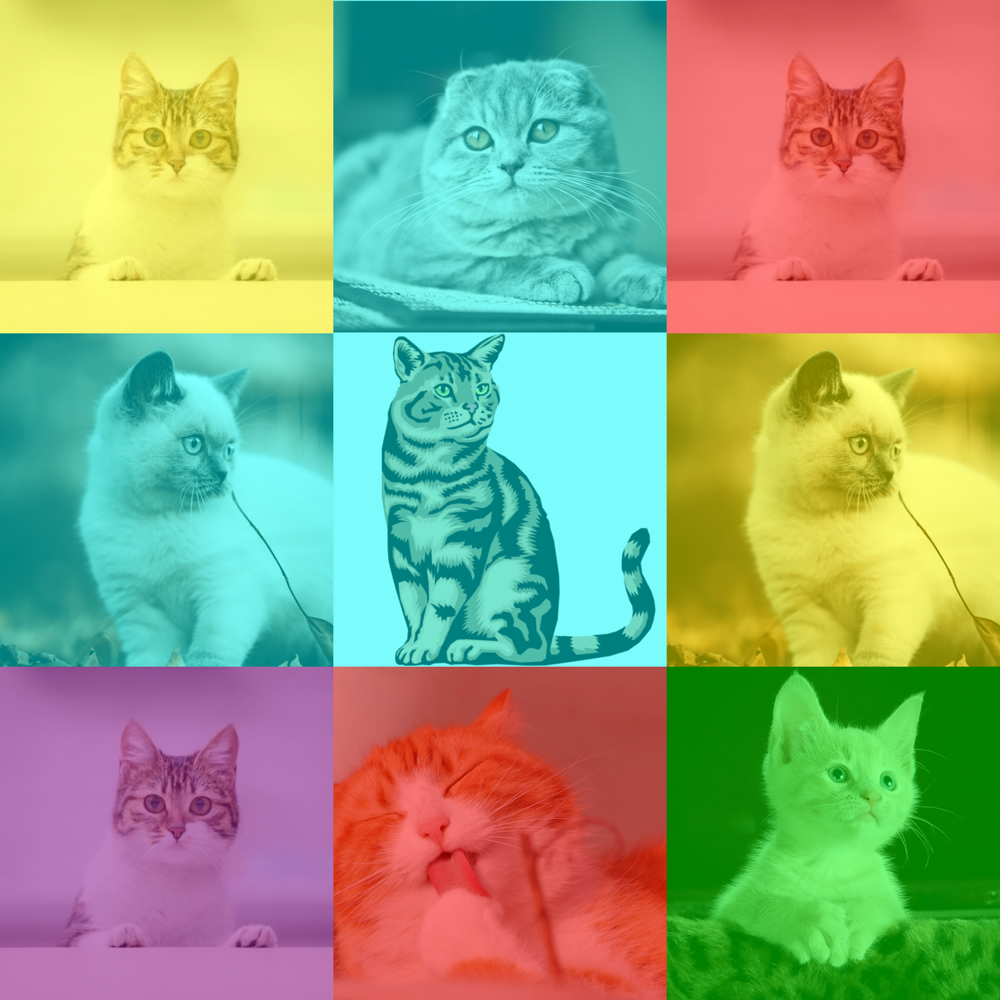

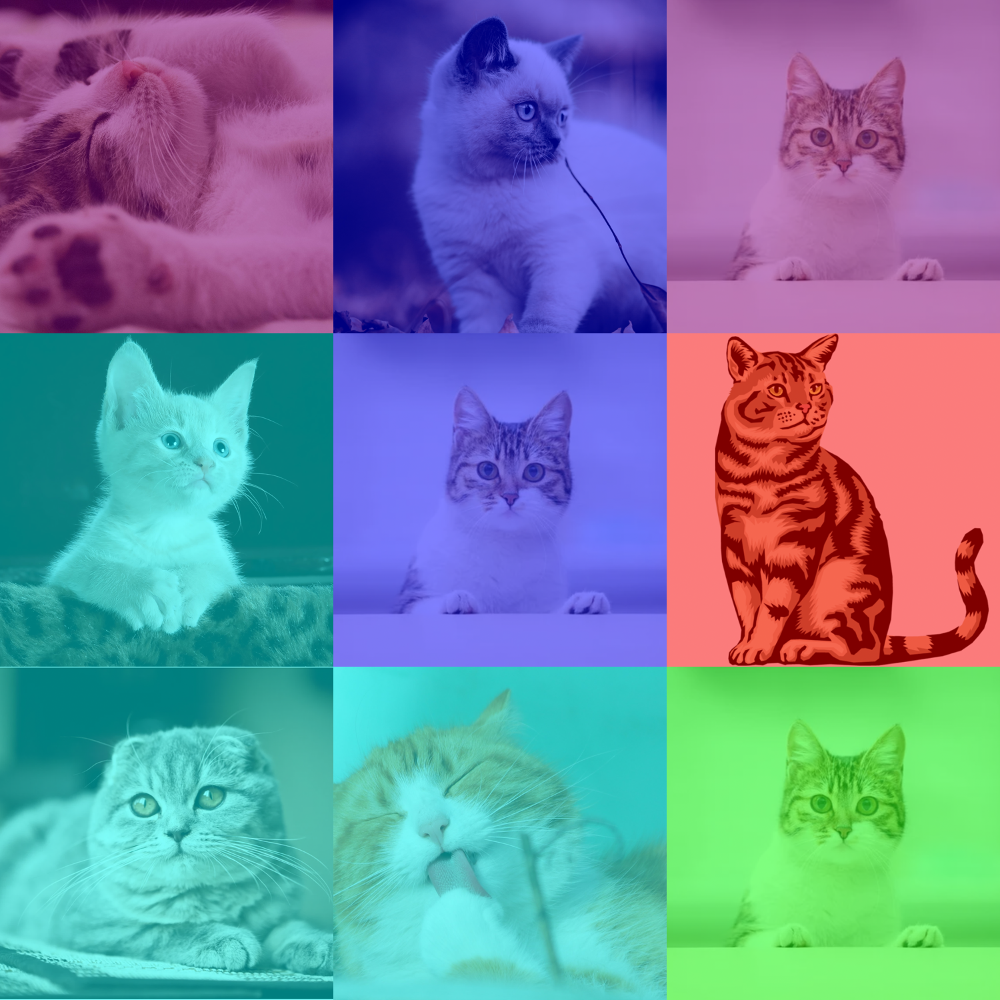

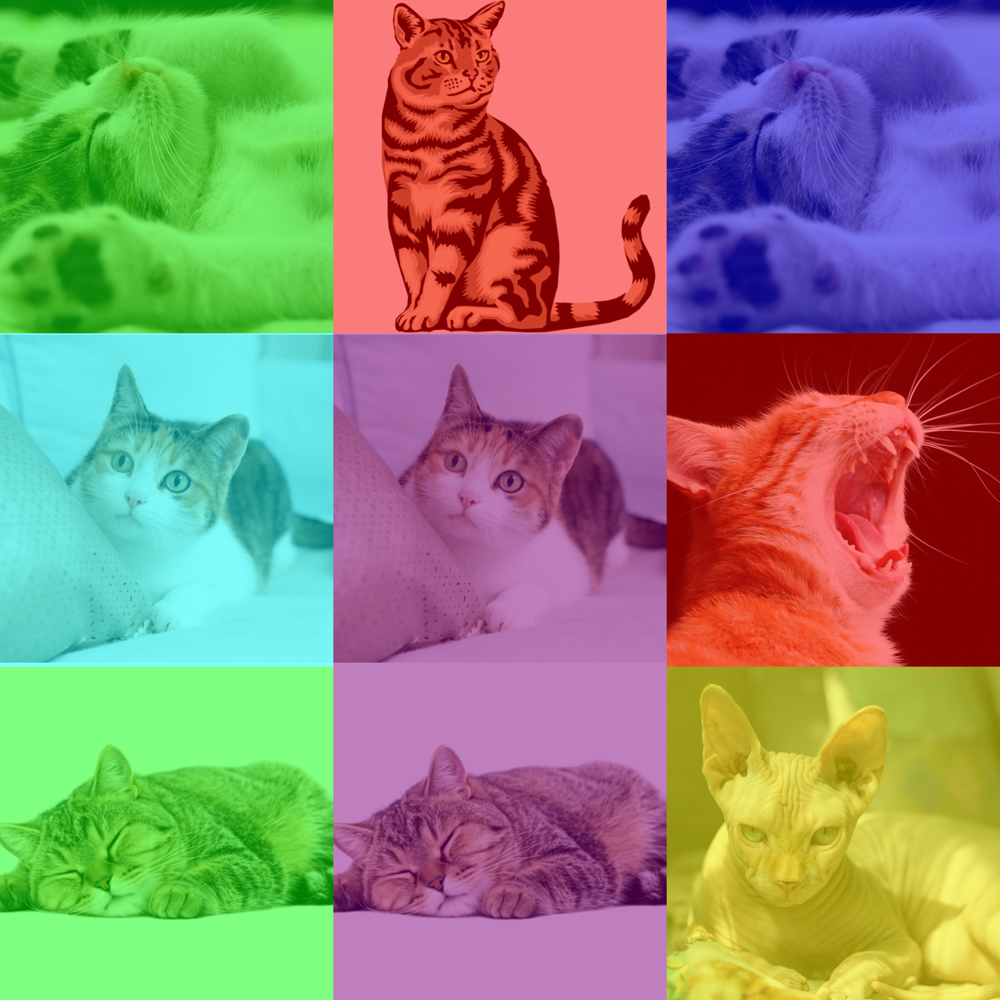

In [56]:
def generate_poster(folder_path, output_dir, columns, rows, num_variants=3):
    # placing all image files in the specified folder
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    
    # Create the output_dir if it doesn't exist
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    posters = []
    for variant in range(num_variants):
        # Initialize a blank poster image
        poster = Image.new('RGB', (columns * 500, rows * 500))

        for i in range(rows):
            for j in range(columns):
                # Select a random image file for each cell in the poster
                image_path = os.path.join(folder_path, random.choice(image_files))
                original_image = Image.open(image_path)

                # Create a square version of the image, resize it, and apply a random filter
                square_image = create_square_image(original_image)
                resized_image = square_image.resize((500, 500))
                filtered_image = apply_random_filter(resized_image)

                # Paste the processed image into the poster
                poster.paste(filtered_image, (j * 500, i * 500))

        # Save the poster to the specified output directory
        poster_filename = f"poster_variant_{variant + 1}.jpg"
        poster_path = os.path.join(output_dir, poster_filename)
        poster.save(poster_path)
        posters.append(poster)

    return posters

# Example usage
folder_path = '/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images'
output_dir = '/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/generated_img'

posters = generate_poster(folder_path, output_dir, columns=3, rows=3, num_variants=4)

# Display the posters in Jupyter Notebook
for poster in posters:
    display(poster)


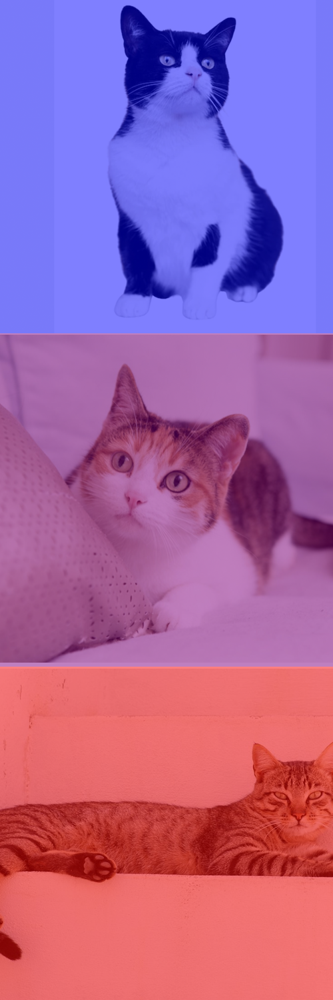

In [61]:
folder_path = '/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/images'
output_dir = '/Users/olgatsyban/Documents/Python_University/Python_lab4_Tsyban_Olga/generated_img2'

posters2 = generate_poster(folder_path, output_dir, columns=1, rows=3, num_variants=1)
for poster in posters2:
    display(poster)

## Link to GitHub: [Lab4](https://github.com/OlgaTsuban/Python_university)

## Link to Nbviever: [Lab4](https://nbviewer.org/github/OlgaTsuban/Python_university/blob/main/Python_lab4_Tsyban_Olga/Python_lab4_TsybanOlga_KN222A.ipynb)